In [72]:
from visual_behavior import utilities as vbu
import visual_behavior.plotting as vbp
from visual_behavior.utilities import EyeTrackingData
from visual_behavior import database as db
import pandas as pd
import matplotlib.pyplot as plt
import os
import numpy as np
import time
import seaborn as sns
import matplotlib.patches as patches

from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.express as px

from scipy import stats

from multiprocessing import Pool

from dro.modules import eye_tracking as et
from dro.modules import plotting as plot_utils

import warnings
warnings.filterwarnings("ignore")

In [3]:
%matplotlib notebook
%widescreen

In [4]:
save_figures = True
figure_savefolder = '/allen/programs/braintv/workgroups/nc-ophys/visual_behavior/eye_tracking_figures/figures_for_analysis_paper'

In [5]:
manifest = pd.read_csv('/allen/programs/braintv/workgroups/nc-ophys/Doug/2019.12.10.sessions_with_tracking.csv')
sessions_to_exclude = pd.read_csv('/allen/programs/braintv/workgroups/nc-ophys/visual_behavior/2019.12.10_eye_tracking_sessions_to_exclude.csv')
manifest = manifest[~manifest['ophys_session_id'].isin(sessions_to_exclude['sessions_to_exclude'].tolist())]

additional_sessions_to_exclude = [
    960475393, #mislabeled session name
]
manifest = manifest[~manifest['ophys_session_id'].isin(additional_sessions_to_exclude)]

In [6]:
eye_dict = {}
pool = Pool(16)
osids = manifest['ophys_session_id'].unique()
ans = pool.map(et.open_eye_data,osids)
eye_dict = {d.ophys_session_id:d for d in ans if d is not None}

opening eye data for osid = 961226856
opening eye data for osid = 954961790
opening eye data for osid = 940775208
opening eye data for osid = 948042811
opening eye data for osid = 935859569
opening eye data for osid = 955991376
opening eye data for osid = 942114744
opening eye data for osid = 938359348
opening eye data for osid = 959454463
opening eye data for osid = 932664150
opening eye data for osid = 925478114
opening eye data for osid = 931687751
opening eye data for osid = 928142719
opening eye data for osid = 929255931
opening eye data for osid = 922743776
opening eye data for osid = 921922878


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 920317769


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 923704003


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 947199653


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 935559843


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 939524851


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 929255311


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 960593969


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 954981981


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 929688369


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 958931715


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 952434025


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 922511481
opening eye data for osid = 943299247


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 923202821


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 938140092


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 932662051


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 941300832


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 927721370


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 933439847


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 954408500


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 959751299


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 957189583


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 939526443


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 948090163


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 929686773


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 928146339


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 922168593


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 920695792


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 937162622


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 919432737


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 931564063


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 927787876


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 918718550


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 917498735


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 915306390


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 914639324


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 913564409


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 910739829


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 907177554


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 906299056


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 940446507


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 901759468


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 894204946


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 916650386


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 889918231


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 888190799
opening eye data for osid = 911719666


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 914797752
opening eye data for osid = 914161594


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 919041767


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 906968227


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 902777219


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 879897824


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 919888953


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 900802327


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 889179793


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 908441202


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 873542787


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 918889065


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 915587736


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 910971181


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 884359468


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 913834848


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 906521029


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 902884228


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 860331718


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 893937838


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 898295293


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 918719819


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 907991198


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 914728054


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 888940531


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 855083235


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 850959798


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 880753403


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 878918807


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 892217026


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 849597937


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 848815078


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 863981645


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 848253761


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 845219209


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 842364341


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 840490733


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 837363020


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 835795999


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 850959102


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 855353286


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 830272668


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 824745199


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 854524023


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 848143026


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 839514418


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 841778484


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 815485890


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 836322359


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 833812106


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 876557230


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 848264483


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 848894137


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 830148632


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 843049997


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 822388759


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 852326785


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 863527124


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 812802821
opening eye data for osid = 849600749


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 841303580


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 839208243


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 835796136


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 833002992


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 855333357


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 825682242


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 846599329


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 809393834


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 819949602


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 808340530


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 811234448


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 807393193


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 806812738


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 805269503


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 799195371


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 798007990


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 794706889


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 848264175


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 842583486


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 848891498


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 775289198


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 807208045


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 804929369


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 799021448


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 808092249


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 809261351


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 797078933


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 794082263


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 806203732


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 807055274


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 807667681


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 798818118
opening eye data for osid = 803223329


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 808387448


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 795217244


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 805643175
opening eye data for osid = 789220000


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

In [7]:
pool = Pool(16)
bd = pool.map(et.open_behavior_data,list(eye_dict.keys()))
behavior_dict = {d.ophys_session_id:d for d in bd if d is not None}

opening behavior data for osid = 959454463
opening behavior data for osid = 955991376
opening behavior data for osid = 954961790
opening behavior data for osid = 932664150
opening behavior data for osid = 938359348
opening behavior data for osid = 948042811
opening behavior data for osid = 942114744
opening behavior data for osid = 940775208
opening behavior data for osid = 935859569
opening behavior data for osid = 931687751
opening behavior data for osid = 961226856
opening behavior data for osid = 929255931
opening behavior data for osid = 925478114
opening behavior data for osid = 921922878
opening behavior data for osid = 928142719
opening behavior data for osid = 922743776


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 935559843
opening behavior data for osid = 958931715
opening behavior data for osid = 960593969
opening behavior data for osid = 932662051


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 927721370


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 941300832


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 952434025


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 947199653


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 920317769


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 938140092


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 922511481


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 923704003


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 929688369


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 939524851


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 929255311


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 954981981


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 959751299
opening behavior data for osid = 933439847
opening behavior data for osid = 957189583


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 927787876


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 923202821


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 931564063


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 943299247


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 922168593


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 937162622


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 940446507


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 920695792


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 929686773


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 928146339


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 948090163


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 939526443


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 954408500


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 919432737


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 918718550


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 917498735


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 915306390


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 914639324


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 913564409


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 910739829


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 907177554


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 906299056


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 901759468


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 894204946


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 889918231


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 888190799


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 879897824


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 873542787


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 860331718


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 919888953


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 919041767


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 916650386


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 914797752


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 914161594


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 911719666


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 908441202


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 906968227


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 902777219


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 900802327


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 893937838


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 889179793


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 884359468


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 878918807


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 863981645


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 855353286


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 918719819


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 918889065


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 915587736


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 914728054


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 913834848


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 910971181


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 907991198


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 906521029


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 902884228
opening behavior data for osid = 898295293


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 892217026


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 880753403
opening behavior data for osid = 888940531


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 876557230


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 863527124


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 855333357


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 855083235


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 850959798


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 849597937


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 848815078


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 848253761


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 845219209


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 842364341


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 840490733


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 837363020


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 835795999


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 830272668


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 824745199


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 815485890


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 809393834


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 808340530


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 807393193


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 854524023


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 850959102


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 848894137


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 848264483


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 848143026


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 843049997


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 841778484


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 839514418


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 836322359


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 833812106


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 830148632


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 812802821
opening behavior data for osid = 822388759


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 852326785
opening behavior data for osid = 808092249


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 809261351


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 807208045


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 849600749


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 848891498


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 846599329


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 848264175


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 842583486


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 841303580


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 839208243


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 835796136


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 833002992


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 825682242


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 811234448


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 819949602


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 806812738
opening behavior data for osid = 808387448


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 807055274


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 807667681


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 805269503


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 799195371


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 798007990


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 794706889


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 775289198


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 804929369


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 806203732


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 799021448


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 794082263


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 797078933


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 803223329


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 805643175


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 798818118


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 789220000


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 795217244


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

In [9]:
with Pool(16) as pool:
    rd = pool.map(et.get_response_data,np.sort(list(behavior_dict.keys())))
response_dict = {d['ophys_session_id']:d for d in rd if d is not None}

opening eye data for osid = 808340530
opening eye data for osid = 830272668
opening eye data for osid = 824745199
opening eye data for osid = 775289198
opening eye data for osid = 809393834
opening eye data for osid = 807393193
opening eye data for osid = 794706889
opening eye data for osid = 805269503
opening eye data for osid = 799195371
opening eye data for osid = 815485890
opening eye data for osid = 837363020
opening eye data for osid = 806812738
opening eye data for osid = 798007990
opening eye data for osid = 840490733
opening eye data for osid = 835795999
opening eye data for osid = 842364341


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 798007990
opening behavior data for osid = 837363020
opening behavior data for osid = 808340530
opening behavior data for osid = 806812738
opening behavior data for osid = 805269503


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 835795999


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 830272668


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 807393193


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 809393834


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 799195371


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 794706889


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 815485890


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 824745199


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 840490733


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 842364341


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 775289198


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 805269503, that took 27.030981302261353 seconds
opening eye data for osid = 805643175


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 840490733, that took 28.488779067993164 seconds
opening eye data for osid = 841303580


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 824745199, that took 29.350162982940674 seconds
opening eye data for osid = 825682242


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 798007990, that took 29.667831659317017 seconds
opening eye data for osid = 798818118


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 809393834, that took 29.790015935897827 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 811234448


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



done with osid = 799195371, that took 29.814749479293823 seconds
opening eye data for osid = 803223329


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 808340530, that took 29.879639625549316 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 808387448


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



done with osid = 830272668, that took 29.89873194694519 seconds
done with osid = 807393193, that took 29.902195692062378 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



done with osid = 842364341, that took 29.89817476272583 seconds
opening eye data for osid = 842583486


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 807667681
opening eye data for osid = 833002992


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 835795999, that took 29.97205400466919 seconds
opening eye data for osid = 835796136


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



done with osid = 806812738, that took 29.990895748138428 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 807055274


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 794706889, that took 30.026198625564575 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 795217244


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 837363020, that took 30.108331203460693 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 839208243


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/Code/visual_behavior_analysis/visual_behavior/utilities.py:407: UserWarning:

no matching sync line for behavior

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use d

done with osid = 815485890, that took 30.702529430389404 seconds
opening eye data for osid = 819949602
done with osid = 775289198, that took 30.734575271606445 seconds
opening eye data for osid = 789220000


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 805643175


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 841303580


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 825682242


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 798818118


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 808387448


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 807667681


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 811234448


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 803223329


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 795217244


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 807055274


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 833002992
opening behavior data for osid = 835796136


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 819949602


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 839208243


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 789220000


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 805643175, that took 27.99033784866333 seconds
opening eye data for osid = 806203732


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 841303580, that took 27.73366379737854 seconds
opening eye data for osid = 841778484


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 803223329, that took 27.670002222061157 seconds
opening eye data for osid = 804929369
done with osid = 807667681, that took 27.649124145507812 seconds
opening eye data for osid = 808092249


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 808387448, that took 27.84097909927368 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 809261351


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 833002992, that took 28.33698534965515 seconds
opening eye data for osid = 833812106
done with osid = 839208243, that took 28.182238817214966 seconds
opening eye data for osid = 839514418


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 798818118, that took 28.7143132686615 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 799021448


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



done with osid = 835796136, that took 28.475005865097046 seconds
opening eye data for osid = 836322359


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 811234448, that took 29.148497343063354 seconds
opening eye data for osid = 812802821
done with osid = 825682242, that took 29.635862588882446 seconds
done with osid = 807055274, that took 29.00328230857849 seconds
opening eye data for osid = 830148632
opening eye data for osid = 807208045


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 795217244, that took 29.094481945037842 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



done with osid = 819949602, that took 28.433772325515747 seconds
opening eye data for osid = 797078933


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 822388759


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 789220000, that took 29.803945779800415 seconds
opening eye data for osid = 794082263


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 842583486


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 842583486, that took 39.45685267448425 seconds
opening eye data for osid = 843049997


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 806203732


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 841778484


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 804929369
opening behavior data for osid = 808092249
opening behavior data for osid = 809261351


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 799021448
opening behavior data for osid = 833812106


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 836322359


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 830148632


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 812802821


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 807208045


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 822388759


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 797078933


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 839514418


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 794082263


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 808092249, that took 25.961342573165894 seconds
opening eye data for osid = 845219209
done with osid = 806203732, that took 28.61636710166931 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 848253761


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 804929369, that took 27.897528171539307 seconds
opening eye data for osid = 848815078


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 841778484, that took 29.779515743255615 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 849597937


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 833812106, that took 28.534975290298462 seconds
opening eye data for osid = 850959798
done with osid = 809261351, that took 29.12734055519104 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 855083235


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



done with osid = 799021448, that took 28.603302478790283 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 860331718


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 836322359, that took 28.87903356552124 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 873542787


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



done with osid = 807208045, that took 28.46339511871338 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 879897824


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 839514418, that took 29.720215320587158 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 888190799


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



done with osid = 822388759, that took 29.00616765022278 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 889918231


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



done with osid = 830148632, that took 29.296669483184814 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 894204946


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 797078933, that took 29.591612339019775 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 901759468
done with osid = 812802821, that took 29.86909580230713 seconds
opening eye data for osid = 906299056


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 794082263, that took 28.778016328811646 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 907177554


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 848253761


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 843049997


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 850959798


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 888190799


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 889918231


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 901759468


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 906299056


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 907177554


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 848253761, that took 27.548189878463745 seconds
opening eye data for osid = 848264175


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 843049997, that took 43.79488968849182 seconds
opening eye data for osid = 910739829


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 888190799, that took 25.791728496551514 seconds
opening eye data for osid = 888940531


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 845219209


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 850959798, that took 27.408439874649048 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 852326785


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 848815078


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 889918231, that took 27.886576414108276 seconds
opening eye data for osid = 892217026


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 901759468, that took 27.646535873413086 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 902777219


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 849597937


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 855083235


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 860331718


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



done with osid = 907177554, that took 27.96876621246338 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 907991198


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 906299056, that took 28.95444893836975 seconds
opening eye data for osid = 906521029


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 873542787


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 879897824


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 894204946


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 845219209, that took 43.67328643798828 seconds
opening eye data for osid = 846599329


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 849597937, that took 42.578006744384766 seconds
opening eye data for osid = 849600749


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 848815078, that took 43.49951148033142 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 848891498


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 888940531


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 855083235, that took 43.95835018157959 seconds
opening eye data for osid = 855333357
done with osid = 860331718, that took 43.875924587249756 seconds
opening eye data for osid = 863527124


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



done with osid = 873542787, that took 43.90807843208313 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 876557230


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 892217026


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



done with osid = 879897824, that took 44.473774433135986 seconds
opening eye data for osid = 880753403


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 902777219


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 907991198


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 894204946, that took 45.27344989776611 seconds
opening eye data for osid = 898295293


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 906521029


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 888940531, that took 27.386414527893066 seconds
opening eye data for osid = 889179793


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 848264175


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 892217026, that took 27.448150157928467 seconds
opening eye data for osid = 893937838


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 910739829


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 902777219, that took 27.949686288833618 seconds
opening eye data for osid = 902884228


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 907991198, that took 27.26271629333496 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 908441202


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 848891498


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 849600749


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 852326785


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



done with osid = 906521029, that took 27.876333236694336 seconds
opening eye data for osid = 906968227


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 855333357


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 863527124


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 898295293


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 848264175, that took 44.42169523239136 seconds
opening eye data for osid = 848264483


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 849600749, that took 28.343249559402466 seconds
opening eye data for osid = 850959102


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 889179793


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 852326785, that took 43.23101186752319 seconds
opening eye data for osid = 854524023


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 848891498, that took 28.701915979385376 seconds
opening eye data for osid = 848894137


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 910739829, that took 44.54318690299988 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 910971181


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 846599329


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 855333357, that took 28.331659078598022 seconds
opening eye data for osid = 855353286


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 893937838


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 863527124, that took 28.834969758987427 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 863981645


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 908441202


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 876557230


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 906968227


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 880753403


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 898295293, that took 28.961915969848633 seconds
opening eye data for osid = 900802327


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



done with osid = 889179793, that took 27.238702058792114 seconds
opening eye data for osid = 913564409


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 893937838, that took 27.051501512527466 seconds
opening eye data for osid = 914639324


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 846599329, that took 44.289485454559326 seconds
opening eye data for osid = 848143026


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 902884228


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 854524023


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 906968227, that took 27.993099212646484 seconds
done with osid = 908441202, that took 29.119383811950684 seconds
opening eye data for osid = 915306390
opening eye data for osid = 917498735


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 876557230, that took 43.72394585609436 seconds
opening eye data for osid = 878918807


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 880753403, that took 43.17533588409424 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 884359468


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 900802327


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 902884228, that took 39.96285581588745 seconds
opening eye data for osid = 918889065


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 913564409


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 854524023, that took 27.833744764328003 seconds
opening eye data for osid = 919888953


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 914639324


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 848264483


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 850959102
opening behavior data for osid = 910971181


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 848894137


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 855353286
opening behavior data for osid = 915306390


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 917498735


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 900802327, that took 27.09362268447876 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 921922878


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 863981645


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 884359468


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 913564409, that took 28.9315402507782 seconds
opening eye data for osid = 913834848


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 914639324, that took 29.66441035270691 seconds
opening eye data for osid = 914728054


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 918889065
done with osid = 848264483, that took 44.879682540893555 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



done with osid = 910971181, that took 42.82479667663574 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 911719666


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 922743776


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 915306390, that took 27.712689876556396 seconds
opening eye data for osid = 915587736


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 919888953


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 850959102, that took 45.15529155731201 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 925478114
opening behavior data for osid = 848143026


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 848894137, that took 44.98338007926941 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 928142719


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 884359468, that took 28.000359535217285 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 929255931


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



done with osid = 917498735, that took 29.508936405181885 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 918718550


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



done with osid = 855353286, that took 44.56464862823486 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 931564063


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 921922878


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 863981645, that took 45.16879725456238 seconds
opening eye data for osid = 932664150


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 878918807


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 918889065, that took 25.536062240600586 seconds
opening eye data for osid = 919041767


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 919888953, that took 25.484636306762695 seconds
opening eye data for osid = 920317769


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 848143026, that took 43.46966505050659 seconds
opening eye data for osid = 935859569


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 911719666


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 921922878, that took 26.588992595672607 seconds
opening eye data for osid = 922168593


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 914728054


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 925478114


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 929255931
done with osid = 878918807, that took 43.757798194885254 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 938359348


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 918718550


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 919041767


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 929255931, that took 23.895241260528564 seconds
opening eye data for osid = 929686773
done with osid = 914728054, that took 26.79677700996399 seconds
opening eye data for osid = 914797752


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 911719666, that took 26.97177767753601 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 940446507


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 925478114, that took 26.13140058517456 seconds
opening eye data for osid = 927721370


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 913834848


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 935859569


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 922743776
done with osid = 918718550, that took 27.688766717910767 seconds
opening eye data for osid = 918719819


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 915587736


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 928142719


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 919041767, that took 23.740017890930176 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 919432737


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 931564063


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 932664150


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 913834848, that took 43.144431352615356 seconds
opening eye data for osid = 914161594


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 920317769


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 935859569, that took 27.480286359786987 seconds
opening eye data for osid = 937162622


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 929686773


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 927721370


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 928142719, that took 41.813634634017944 seconds
opening eye data for osid = 928146339


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 922743776, that took 44.119887590408325 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 923202821


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



done with osid = 931564063, that took 41.83569121360779 seconds
opening eye data for osid = 931687751


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 915587736, that took 44.483373165130615 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 916650386


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 922168593


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 932664150, that took 43.89791655540466 seconds
opening eye data for osid = 933439847


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 938359348


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 927721370, that took 26.147822618484497 seconds
opening eye data for osid = 927787876


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 929686773, that took 27.799084186553955 seconds
opening eye data for osid = 929688369


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 920317769, that took 44.83983588218689 seconds
opening eye data for osid = 920695792


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 914161594


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 914797752
done with osid = 922168593, that took 41.4589102268219 seconds
opening eye data for osid = 922511481


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 940446507


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 937162622


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 928146339


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 918719819


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 931687751


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 916650386


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 938359348, that took 45.097914695739746 seconds
opening eye data for osid = 939524851


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 919432737


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 933439847


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



done with osid = 914161594, that took 28.043205499649048 seconds
opening eye data for osid = 942114744


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 937162622, that took 26.87992262840271 seconds
opening eye data for osid = 938140092


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 927787876


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



done with osid = 914797752, that took 43.249439001083374 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 948042811


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 929688369


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 920695792


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



done with osid = 931687751, that took 25.84678602218628 seconds
opening eye data for osid = 932662051


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 940446507, that took 45.47018122673035 seconds
opening eye data for osid = 940775208


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 928146339, that took 29.240773677825928 seconds
opening eye data for osid = 929255311


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 922511481


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 916650386, that took 28.137189626693726 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 954408500


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 933439847, that took 25.855345964431763 seconds
opening eye data for osid = 935559843


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 918719819, that took 44.34096884727478 seconds
opening eye data for osid = 955991376


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 923202821


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



done with osid = 919432737, that took 44.6532883644104 seconds
opening eye data for osid = 959454463


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 939524851


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 929688369, that took 26.070534467697144 seconds
opening eye data for osid = 961226856


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 920695792, that took 26.444369316101074 seconds
done with osid = 927787876, that took 28.619168281555176 seconds
opening behavior data for osid = 938140092


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 922511481, that took 28.24386501312256 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening behavior data for osid = 948042811


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 932662051


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 939524851, that took 24.13554835319519 seconds
opening eye data for osid = 939526443


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 923202821, that took 43.53866934776306 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.



opening eye data for osid = 923704003


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 954408500


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 935559843
opening behavior data for osid = 940775208


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 955991376


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 929255311


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 959454463


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 932662051, that took 23.344939708709717 seconds
done with osid = 938140092, that took 25.93259048461914 seconds
opening behavior data for osid = 961226856


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 942114744


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 948042811, that took 26.402136087417603 seconds
opening eye data for osid = 948090163


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 954408500, that took 23.109241724014282 seconds
opening eye data for osid = 954961790


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 935559843, that took 22.58048725128174 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 940775208, that took 26.84339451789856 seconds
opening eye data for osid = 941300832


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 955991376, that took 24.839450120925903 seconds
opening eye data for osid = 957189583


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 923704003


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 929255311, that took 28.278457403182983 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 939526443


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 959454463, that took 24.74193000793457 seconds
opening eye data for osid = 959751299


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 961226856, that took 24.94019889831543 seconds
done with osid = 942114744, that took 38.32126712799072 seconds
opening eye data for osid = 943299247


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 948090163


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 954961790


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 923704003, that took 21.486209630966187 seconds
opening behavior data for osid = 957189583


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 939526443, that took 23.075108528137207 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 959751299


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 948090163, that took 16.90958881378174 seconds
opening eye data for osid = 952434025


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 954961790, that took 19.82112431526184 seconds
opening eye data for osid = 954981981


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 941300832


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 957189583, that took 19.9970440864563 seconds
opening eye data for osid = 958931715


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 952434025


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 959751299, that took 20.809959173202515 seconds
opening eye data for osid = 960593969


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 943299247


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 954981981


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 958931715


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 941300832, that took 30.61508297920227 seconds
done with osid = 952434025, that took 18.479156970977783 seconds
opening behavior data for osid = 960593969


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 954981981, that took 19.457699298858643 seconds
done with osid = 943299247, that took 30.12568187713623 seconds
opening eye data for osid = 947199653


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 958931715, that took 17.222054481506348 seconds


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 960593969, that took 17.866828441619873 seconds
opening behavior data for osid = 947199653


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

done with osid = 947199653, that took 17.436744928359985 seconds


## look at an example session in time

In [10]:
osid = 955991376 #manifest.sample(random_state=6)['ophys_session_id'].iloc[0]

bd = et.open_behavior_data(osid)
ed = et.open_eye_data(osid)

opening behavior data for osid = 955991376


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 955991376


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

<IPython.core.display.Javascript object>


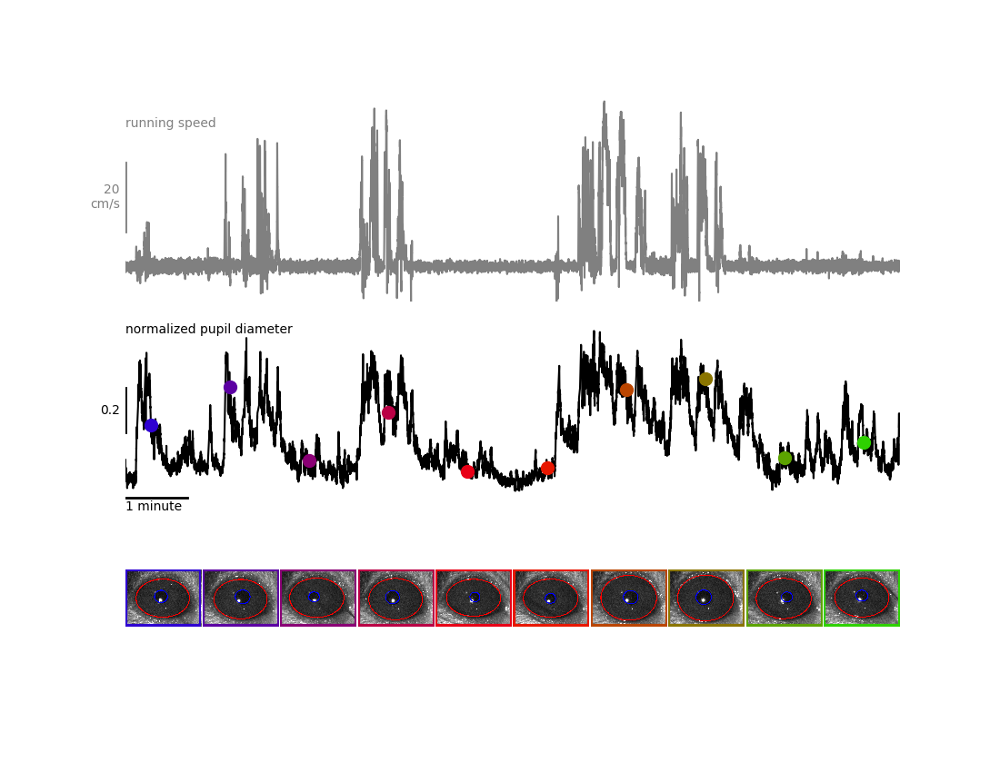

In [11]:
# fig,ax=plt.subplots(2,1,sharex=True,figsize=(12,6))
fig=plt.figure(figsize=(12,6))
ax = [
    vbp.placeAxesOnGrid(fig,xspan=(0,1),yspan=(0,0.35)),
    vbp.placeAxesOnGrid(fig,xspan=(0,1),yspan=(0.35,0.7))
]
N = 10
ax_frames = [vbp.placeAxesOnGrid(fig,xspan=(n*1/N,(n+1)*1/N),yspan=(0.7,1)) for n in range(10)]


ax[0].plot(
    bd.running['time'],
    bd.running['speed'],
    color='gray'
)

dfp = ed.ellipse_fits['pupil'].rename(columns={'t':'time'})
ax[1].plot(
    dfp['time'],
    dfp['normalized_blink_corrected_area'],
    color='black'
)

ax[0].set_ylabel('running_speed (cm/s)')
ax[1].set_ylabel('pupil diameter (pixels**2)')
ax[1].set_xlabel('session time')

for axis in ax:
    axis.axis('off')

ax[0].set_xlim(1300,2050)
ax[1].set_xlim(1300,2050)

plt.subplots_adjust(hspace=-0.1)

ax[0].set_ylim(-10,50)
ax[1].set_ylim(0.15,1.1)

ax[0].text(1300,40,'running speed',color='gray')
ax[1].text(1300,0.95,'normalized pupil diameter',color='black')

ax[1].plot([1300,1360],[0.2,0.2],linewidth=2,color='black')
ax[1].text(1300,0.19,'1 minute',va='top')


ax[1].plot([1300,1300],[0.5,0.7],linewidth=2,color='black')
ax[1].text(1295,0.6,'0.2',va='center',ha='right')

ax[0].plot([1300,1300],[10,30],linewidth=2,color='gray')
ax[0].text(1295,20,'20\ncm/s',va='center',ha='right',color='gray')

palette = sns.color_palette("brg", 10)
for ii,t in enumerate(np.linspace(1325,2015,10)):
    rect = patches.Rectangle((0,0),399,299,linewidth=3,edgecolor=palette[ii],facecolor='none')
    
    ax_frames[ii].imshow(ed.get_annotated_frame(time=t)[125:425,100:500])
    ax_frames[ii].axis('off')
    ax_frames[ii].add_patch(rect)
    
    idx = np.abs(dfp['time'] - t).argmin()
    ax[1].plot(
        dfp.loc[idx]['time'],
        dfp.loc[idx]['normalized_blink_corrected_area'],
        marker='o',
        markersize=10,
        color=palette[ii],
    )
    
fig_title = 'data_sample'
if save_figures:
    vbp.save_figure(fig,os.path.join(figure_savefolder,fig_title),formats=['.pdf','.png'])

## get averages around the omission

In [12]:
df_omitted_means = pd.DataFrame()

for ids,session in manifest.iterrows():
    df = response_dict[session['ophys_session_id']]['pupil_area']['omitted_stim']
    
    if 't' in df.columns:
        time_parameter = 't'
    elif 'time' in df.columns:
        time_parameter = 'time'
        
    cols = [col for col in df.columns if col != time_parameter]
    mean_response = et.convert_to_fraction(df)[cols].mean(axis=1)
    
    if len(df_omitted_means) == 0:
        df_omitted_means['time'] = df[time_parameter]
    
    df_omitted_means[session['ophys_session_id']] = mean_response


<IPython.core.display.Javascript object>


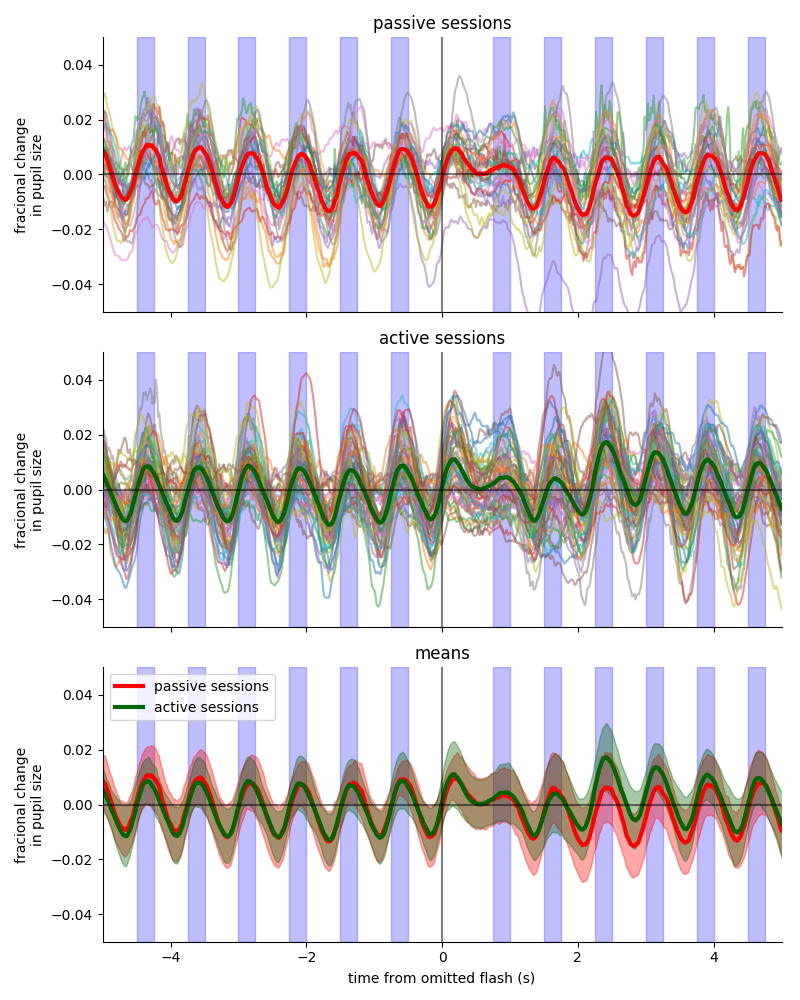

In [13]:
passive_sessions = manifest[(manifest['stage_name'].str.contains('passive'))&(manifest['project_code']=='VisualBehavior')]
active_sessions = manifest[(~manifest['stage_name'].str.contains('passive'))&(manifest['project_code']=='VisualBehavior')]

fig,ax=plt.subplots(3,1,figsize=(8,10),sharex=True,sharey=True)
for osid in passive_sessions['ophys_session_id'].unique():
    ax[0].plot(df_omitted_means['time'],df_omitted_means[osid],alpha=0.5)
for osid in active_sessions['ophys_session_id'].unique():
    ax[1].plot(df_omitted_means['time'],df_omitted_means[osid],alpha=0.5)
    
for ii in [0,2]:
    ax[ii].plot(df_omitted_means['time'],df_omitted_means[passive_sessions['ophys_session_id'].unique()].mean(axis=1),alpha=1,linewidth=3,color='red')
for ii in [1,2]:
    ax[ii].plot(df_omitted_means['time'],df_omitted_means[active_sessions['ophys_session_id'].unique()].mean(axis=1),alpha=1,linewidth=3,color='darkgreen')

for sessions,color in zip([passive_sessions,active_sessions],['red','darkgreen']):
    cols = sessions['ophys_session_id'].unique()
    ax[2].fill_between(
        df_omitted_means['time'], 
        df_omitted_means[cols].mean(axis=1) + df_omitted_means[cols].std(axis=1), 
        df_omitted_means[cols].mean(axis=1) - df_omitted_means[cols].std(axis=1), 
        color=color, 
        alpha=0.35
    )
    
ax[0].set_title('passive sessions')
ax[1].set_title('active sessions')
ax[2].set_title('means')
ax[2].legend(['passive sessions','active sessions'])

ax[0].set_xlim(-5,5)
ax[0].set_ylim(-.05,.05)
for ii in range(3):
    ax[ii].axvline(0,color='black',alpha=0.5)
    ax[ii].axhline(0,color='black',alpha=0.5)
    et.designate_flashes(ax[ii],omit=0)
    ax[ii].set_ylabel("fracional change\nin pupil size")
ax[2].set_xlabel('time from omitted flash (s)')

sns.despine()
fig.tight_layout()


<IPython.core.display.Javascript object>


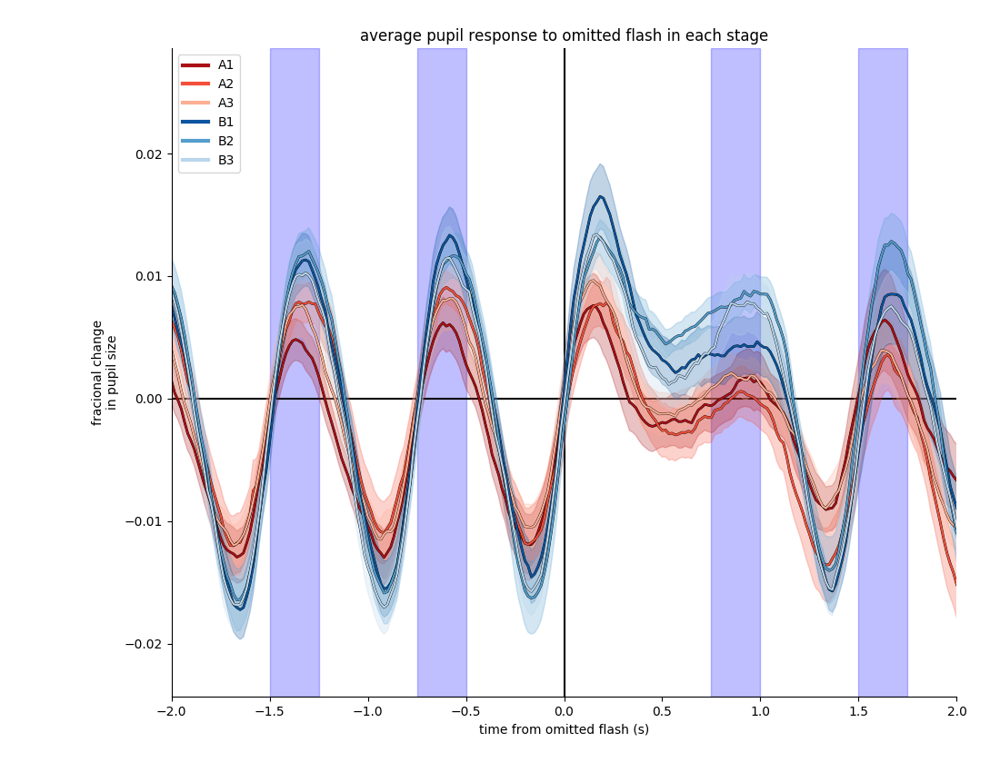

In [14]:
fig,ax=plt.subplots(figsize=(6,6))
stage_names = np.sort(manifest[manifest['project_code']=='VisualBehavior']['stage_name'].unique())
                        
plot_utils.initialize_legend(ax,[et.get_session_color(et.get_session_name(stage_name)) for stage_name in stage_names],linewidth=3)

for stage_name in stage_names:

    sessions = manifest.query('stage_name == @stage_name')
    session_name = et.get_session_name(stage_name)
    cols = sessions['ophys_session_id'].unique()
    for lt,color in zip([2,1.5],['black',et.get_session_color(session_name)]):
        ax.plot(
            df_omitted_means['time'],
            df_omitted_means[cols].mean(axis=1),
            alpha=1,
            linewidth=lt,
            color=color
        )
    ax.fill_between(
        df_omitted_means['time'], 
        df_omitted_means[cols].mean(axis=1) + df_omitted_means[cols].std(axis=1)/np.sqrt(len(cols)), 
        df_omitted_means[cols].mean(axis=1) - df_omitted_means[cols].std(axis=1)/np.sqrt(len(cols)), 
        color=et.get_session_color(session_name), 
        alpha=0.25
    )
ax.set_xlim(-2,2)
    
ax.legend([et.get_session_name(stage_name) for stage_name in stage_names])

sns.despine()

ax.set_title('average pupil response to omitted flash in each stage')
ax.set_ylabel("fracional change\nin pupil size")
ax.set_xlabel('time from omitted flash (s)')

ax.axvline(0,color='k',zorder=-np.inf)
ax.axhline(0,color='k',zorder=-np.inf)

et.designate_flashes(ax,omit=0)
fig.tight_layout()

fig_title = 'omitted_flash_response'
if save_figures:
    vbp.save_figure(fig,os.path.join(figure_savefolder,fig_title),formats=['.pdf','.png'])

In [75]:
df_omitted_means

,time,961226856,960593969,959751299,959454463,958931715,957189583,955991376,954981981,954408500,954961790,952434025,948090163,948042811,947199653,943299247,942114744,941300832,940446507,940775208,939524851,939526443,938359348,938140092,937162622,935859569,935559843,933439847,932664150,932662051,931564063,931687751,929688369,929686773,929255931,929255311,928146339,928142719,927721370,927787876,925478114,923704003,923202821,922743776,922511481,922168593,921922878,920317769,920695792,919432737,919888953,918719819,918718550,919041767,918889065,917498735,916650386,915587736,915306390,914797752,914728054,914639324,914161594,913834848,913564409,911719666,910971181,910739829,908441202,907991198,907177554,906968227,906521029,906299056,902777219,902884228,901759468,900802327,898295293,894204946,893937838,892217026,889918231,889179793,888940531,888190799,884359468,880753403,879897824,878918807,876557230,873542787,863981645,863527124,860331718,855353286,855333357,855083235,854524023,852326785,850959798,850959102,849600749,849597937,848894137,848891498,848815078,848264483,848264175,848253761,848143026,846599329,845219209,843049997,842583486,842364341,841778484,841303580,840490733,839514418,839208243,837363020,836322359,835796136,835795999,833812106,833002992,830272668,830148632,825682242,824745199,822388759,819949602,815485890,812802821,811234448,809393834,809261351,808387448,808340530,808092249,807667681,807393193,807208045,807055274,806812738,806203732,805643175,805269503,804929369,803223329,799195371,799021448,798818118,798007990,797078933,795217244,794706889,794082263,789220000,775289198
0,-10.000000,-0.005884,-0.013546,0.021560,-0.002777,-0.005446,-0.035784,-0.005033,-0.010344,0.007808,0.002636,-0.025396,-0.005675,-0.001784,-0.000362,-0.013044,-0.009745,-0.007583,-0.008314,-0.013898,-0.050877,-0.010388,-0.005225,-0.019532,-0.041407,0.000281,-0.023943,-0.022820,-0.000687,-0.007495,-0.006969,-0.020746,-0.007859,0.008371,-0.012805,-0.004671,-0.009642,-0.011759,-0.013535,-0.002781,-0.009552,-0.010091,-0.002158,0.007608,-0.004156,0.013359,-0.004339,0.000866,-0.022854,-0.020438,0.010695,-0.021746,-0.018745,-0.014559,-0.010033,-0.024485,-0.002140,0.004304,-0.014306,-0.009957,-0.013939,-0.003156,-0.012738,-0.015407,-0.014783,-0.009013,-0.008785,-0.013974,-0.026238,-0.014218,-0.010208,-0.014554,-0.008284,-0.003028,0.004061,-0.010183,-0.007142,-0.001538,-0.017500,-0.010046,-0.001535,-0.023291,0.003632,-0.005502,-0.014207,0.010444,0.002808,0.003534,-0.010243,-0.013145,0.024018,0.012399,-0.007412,0.003665,0.017093,-0.027792,0.018350,0.016317,0.016055,-0.006032,-0.012283,-0.021945,-0.002012,-0.009665,-0.027823,-0.016666,-0.021585,-0.005166,-0.001999,-0.016994,-0.012253,-0.009014,0.000967,0.007308,-0.002548,-0.022584,-0.010037,-0.017513,-0.008423,0.002471,-0.005565,-0.016007,-0.028524,-0.010041,0.003466,-0.015150,-0.002812,0.003519,0.006724,-0.005860,-0.011391,-0.008588,-0.016397,0.009212,-0.017186,0.020741,-0.017721,0.003746,-0.008497,-0.003507,-0.018431,-0.019175,-0.008621,0.001235,-0.021196,-0.000131,-0.007002,-0.008291,0.009610,-0.001036,-0.005772,-0.015668,0.011722,0.005767,-0.014990,-0.013629,-0.025949,-0.011246,-3.352759e-02,-0.022334,0.004594
1,-9.983333,-0.005645,-0.013588,0.020867,-0.003481,-0.005833,-0.035134,-0.004774,-0.010326,0.007898,0.002170,-0.025304,-0.005502,-0.002035,-0.000636,-0.013889,-0.010322,-0.008007,-0.008126,-0.013952,-0.050494,-0.011396,-0.005470,-0.019189,-0.041792,0.000722,-0.024424,-0.023332,-0.002024,-0.007272,-0.007417,-0.021201,-0.007552,0.008242,-0.012398,-0.004943,-0.010095,-0.012723,-0.013144,-0.003126,-0.009972,-0.010845,-0.002335,0.007382,-0.004242,0.014120,-0.004586,0.000124,-0.023551,-0.020452,0.010892,-0.022306,-0.018354,-0.014467,-0.010367,-0.024879,-0.002215,0.002468,-0.014652,-0.008979,-0.013848,-0.003729,-0.013243,-0.016876,-0.015424,-0.009239,-0.007515,-0.014129,-0.027478,-0.014107,-0.010490,-0.015038,-0.008596,-0.003084,0.003904,-0.010138,-0.007595,-0.002188,-0.017736,-0.010075,-0.001656,-0.023626,0.

In [78]:
fig = go.Figure()
osids = manifest['ophys_session_id'].unique()

for osid in osids:
    fig.add_trace(
            go.Scatter(
                x = df_omitted_means['time'],
                y = df_omitted_means[osid],
                opacity=0.25,
                showlegend=False,
                name=col,
            ),
        )
fig.show() 


<IPython.core.display.Javascript object>


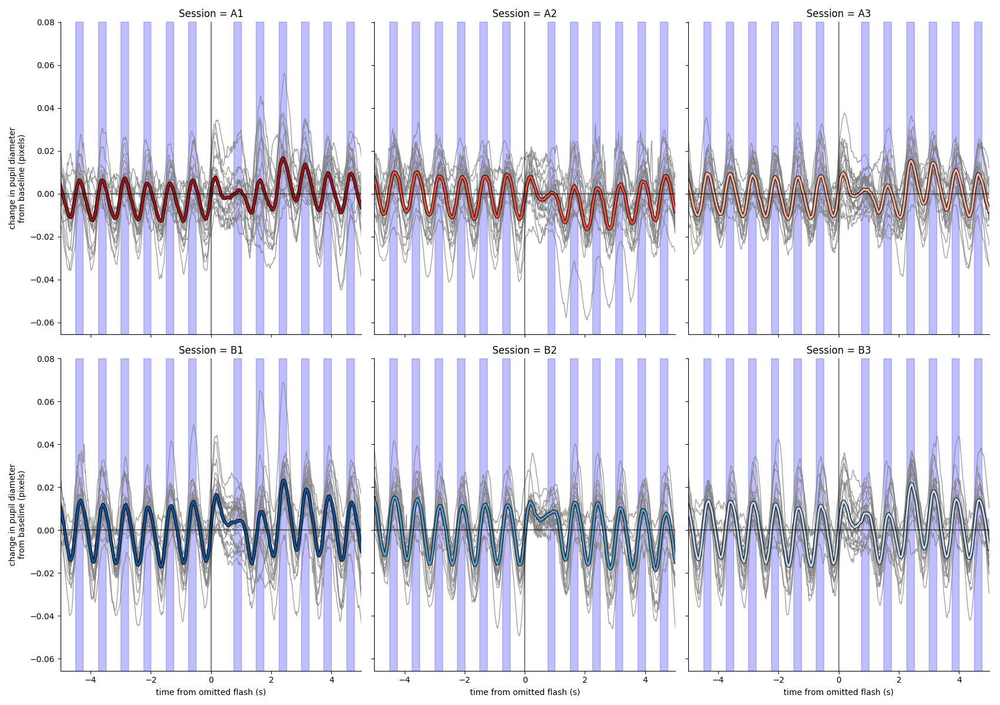

In [15]:
fig,axes=plt.subplots(2,3,sharex=True,sharey=True,figsize=(17,12))
for ii,ax in enumerate(axes.flatten()):
    stage_name = stage_names[ii]
    sessions = manifest.query('stage_name == @stage_name')
    session_name = et.get_session_name(stage_name)
    cols = sessions['ophys_session_id'].unique()
    
    for col in cols:
        ax.plot(
            df_omitted_means['time'],
            df_omitted_means[col],
            alpha=0.75,
            linewidth=1,
            color='gray', #et.get_session_color(session_name)
        )
    
    for lt,color in zip([4,2.5],['black',et.get_session_color(session_name)]):
        ax.plot(
            df_omitted_means['time'],
            df_omitted_means[cols].mean(axis=1),
            alpha=1,
            linewidth=lt,
            color=color
        )
    ax.set_title('Session = {}'.format(session_name))
    
    ax.axvline(0,color='black',alpha=0.5)
    ax.axhline(0,color='black',alpha=0.5)
    
    ax.set_xlim(-5,5)
    et.designate_flashes(ax,omit=0)

for ii in [0,3]:
    axes.flatten()[ii].set_ylabel("change in pupil diameter\nfrom baseline (pixels)")
for ii in [3,4,5]:
    axes.flatten()[ii].set_xlabel('time from omitted flash (s)')
    
fig.tight_layout()
sns.despine()

## hit and CR trials?

In [16]:
df_hit = pd.DataFrame()
df_cr = pd.DataFrame()

for ids,session in manifest.iterrows():
    dfh = response_dict[session['ophys_session_id']]['pupil_area']['hit']
    dfcr = response_dict[session['ophys_session_id']]['pupil_area']['cr']
    
    if 't' in df.columns:
        time_parameter = 't'
    elif 'time' in df.columns:
        time_parameter = 'time'
        
    cols_h = [col for col in dfh.columns if col != time_parameter]
    mean_response_hit = et.convert_to_fraction(dfh)[cols_h].mean(axis=1)
    cols_cr = [col for col in dfcr.columns if col != time_parameter]
    mean_response_cr = et.convert_to_fraction(dfcr)[cols_cr].mean(axis=1)
    
    if len(df_hit) == 0:
        df_hit['time'] = dfh[time_parameter]
        df_cr['time'] = dfcr[time_parameter]
    
    df_hit[session['ophys_session_id']] = mean_response_hit
    df_cr[session['ophys_session_id']] = mean_response_cr

In [17]:
active_sessions = manifest[~(manifest['stage_name'].str.contains('passive'))&(manifest['project_code']=='VisualBehavior')]
active_sessions

,index,_id,container_id,container_workflow_state,date_of_acquisition,donor_id,driver_line,entry_time_utc,equipment_name,experiment_workflow_state,foraging_id,full_genotype,imaging_depth,ophys_experiment_id,ophys_session_id,project_code,reporter_line,retake_number,session_name,sex,stage_name,targeted_structure,eye_tracking_exists
12,626,5d9cfaa0c4a4e2e88bd7a626,929913236,holding,2019-09-23 15:41:38.000000,875479693,Vip-IRES-Cre,2019-10-10 00:09:12.562199,CAM2P.4,passed,c1dbe066-5c05-44b3-ae2a-dde7fdd377cc,Vip-IRES-Cre/wt;Ai148(TIT2L-GC6f-ICL-tTA2)/wt,175.0,953443028,952434025,VisualBehavior,Ai148(TIT2L-GC6f-ICL-tTA2),0.0,20190923_468866_6imagesB,F,OPHYS_6_images_B,VISp,True
15,180,5d841b4a6af48808ce34bf0f,929913236,holding,2019-09-17 17:39:10.000000,875479693,Vip-IRES-Cre,2019-10-10 00:09:10.111142,CAM2P.4,passed,949e0a1e-e5c2-4a29-97c2-a8ce73a1f220,Vip-IRES-Cre/wt;Ai148(TIT2L-GC6f-ICL-tTA2)/wt,175.0,948507789,948090163,VisualBehavior,Ai148(TIT2L-GC6f-ICL-tTA2),2.0,20190917_468866_3imagesA,F,OPHYS_3_images_A,VISp,True
21,25,5d841b4a6af48808ce34be74,930022332,holding,2019-09-11 15:32:03.000000,854625254,Slc17a7-IRES2-Cre,2019-10-09 23:55:45.062309,CAM2P.3,passed,5b2ef631-d476-4647-a4fc-cd3db5ae8f0b,Slc17a7-IRES2-Cre/wt;Camk2a-tTA/wt;Ai93(TITL-G...,175.0,944366183,943299247,VisualBehavior,Ai93(TITL-GCaMP6f),0.0,20190911_459777_6ImagesB,F,OPHYS_6_images_B,VISp,True
25,24,5d841b4a6af48808ce34be73,930022332,holding,2019-09-09 15:32:34.000000,854625254,Slc17a7-IRES2-Cre,2019-10-09 23:55:48.403087,CAM2P.3,passed,b0a19f0d-f576-4d31-803a-f73d17a43df0,Slc17a7-IRES2-Cre/wt;Camk2a-tTA/wt;Ai93(TITL-G...,175.0,942043482,941300832,VisualBehavior,Ai93(TITL-GCaMP6f),0.0,20190909_459777_4ImagesB,F,OPHYS_4_images_B,VISp,True
28,21,5d841b4a6af48808ce34be70,930022332,holding,2019-09-06 15:20:35.000000,854625254,Slc17a7-IRES2-Cre,2019-10-09 23:55:49.007746,CAM2P.3,passed,3329a01d-c8f6-4734-8193-59bf385c9a1e,Slc17a7-IRES2-Cre/wt;Camk2a-tTA/wt;Ai93(TITL-G...,175.0,940852658,940446507,VisualBehavior,Ai93(TITL-GCaMP6f),0.0,20190906_459777_3ImagesA,F,OPHYS_3_images_A,VISp,True
30,178,5d841b4a6af48808ce34bf0d,929913236,holding,2019-09-05 16:05:07.000000,875479693,Vip-IRES-Cre,2019-10-10 00:09:10.813185,CAM2P.4,passed,0a0b055c-93fc-4b27-a82e-8f8dd49f016c,Vip-IRES-Cre/wt;Ai148(TIT2L-GC6f-ICL-tTA2)/wt,175.0,940352989,939524851,VisualBehavior,Ai148(TIT2L-GC6f-ICL-tTA2),1.0,20190905_468866_1imagesA,F,OPHYS_1_images_A,VISp,True
109,309,5d841b4b6af48808ce34bf90,902748650,container_qc,2019-06-25 17:52:54.000000,847076515,Slc17a7-IRES2-Cre,2019-10-10 00:01:30.316527,CAM2P.3,passed,c57a1301-2e4b-4781-a5d4-d029ff75a97d,Slc17a7-IRES2-Cre/wt;Camk2a-tTA/wt;Ai93(TITL-G...,375.0,894726001,894204946,VisualBehavior,Ai93(TITL-GCaMP6f),0.0,20190625_456917_6imagesB,F,OPHYS_6_images_B,VISp,True
110,315,5d841b4b6af48808ce34bf96,890047007,postprocessing,2019-06-25 15:37:48.000000,847074139,Slc17a7-IRES2-Cre,2019-10-10 00:01:31.580275,CAM2P.5,passed,5e75dd6e-a683-45e9-993c-d5bac47837c8,Slc17a7-IRES2-Cre/wt;Camk2a-tTA/wt;Ai93(TITL-G...,175.0,894727297,893937838,VisualBehavior,Ai93(TITL-GCaMP6f),0.0,20190625_456916_6ImagesB,F,OPHYS_6_images_B,VISp,True
113,314,5d841b4b6af48808ce34bf95,890047007,postprocessing,2019-06-21 15:39:45.000000,847074139,Slc17a7-IRES2-Cre,2019-10-10 00:01:31.834558,CAM2P.5,passed,74592c61-adec-4765-860e-59e99f3cf9a6,Slc17a7-IRES2-Cre/wt;Camk2a-tTA/wt;Ai93(TITL-G...,175.0,892799212,892217026,VisualBehavior,Ai93(TITL-GCaMP6f),0.0,20190621_456916_4ImagesB,F,OPHYS_4_images_B,VISp,True
118,492,5d841b4c6af48808ce34c047,876461613,postprocessing,2019-06-18 17:37:36.000000,842724844,Slc17a7-IRES2-Cre,2019-10-10 00:08:49.462674,CAM2P.4,passed,e1abb507-c987-477f-977c-60b08a3188dd,Slc17a7-IRES2-Cre/wt;Camk2a-tTA/wt;Ai93(TITL-G...,175.0,889775742,889179793,VisualBehavior,Ai93(TITL-GCaMP6f),0.0,20190618_453913_4imagesB,F,OPHYS_4_images_B,VISp,True


<IPython.core.display.Javascript object>


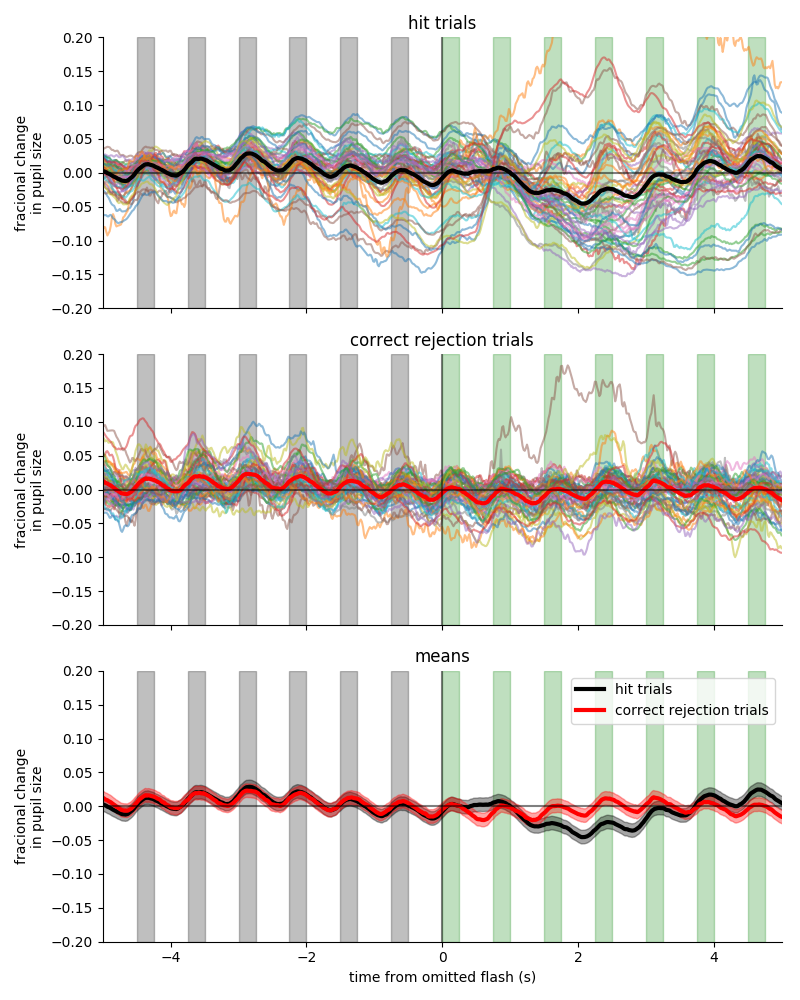

In [18]:
active_sessions = manifest[~(manifest['stage_name'].str.contains('passive'))&(manifest['project_code']=='VisualBehavior')]

fig,ax=plt.subplots(3,1,figsize=(8,10),sharex=True,sharey=True)
for osid in active_sessions['ophys_session_id'].unique():
    ax[0].plot(df_hit['time'],df_hit[osid],alpha=0.5)
    ax[1].plot(df_cr['time'],df_cr[osid],alpha=0.5)
    
    
for ii in [0,2]:
    ax[ii].plot(df_hit['time'],df_hit[active_sessions['ophys_session_id'].unique()].mean(axis=1),alpha=1,linewidth=3,color='black')
for ii in [1,2]:
    ax[ii].plot(df_cr['time'],df_cr[active_sessions['ophys_session_id'].unique()].mean(axis=1),alpha=1,linewidth=3,color='red')

for df,color in zip([df_hit,df_cr],['black','red']):
    cols = active_sessions['ophys_session_id'].unique()
    ax[2].fill_between(
        df['time'], 
        df[cols].mean(axis=1) + 0.01, # + df[cols].std(axis=1)/np.sqrt(len(cols)), 
        df[cols].mean(axis=1) - 0.01, #df[cols].std(axis=1)/np.sqrt(len(cols)), 
        color=color, 
        alpha=0.35
    )
    
ax[0].set_title('hit trials')
ax[1].set_title('correct rejection trials')
ax[2].set_title('means')
ax[2].legend(['hit trials','correct rejection trials'])

ax[0].set_xlim(-5,5)
ax[0].set_ylim(-.2,.2)
for ii in range(3):
    ax[ii].axvline(0,color='black',alpha=0.5)
    ax[ii].axhline(0,color='black',alpha=0.5)
    et.designate_flashes(ax[ii],pre_color='black',post_color='green')
    ax[ii].set_ylabel("fracional change\nin pupil size")
ax[2].set_xlabel('time from omitted flash (s)')

sns.despine()
fig.tight_layout()

In [19]:
active_sessions = manifest[~(manifest['stage_name'].str.contains('passive'))&(manifest['project_code']=='VisualBehavior')]
active_sessions['ophys_session_id'].unique()

array([952434025, 948090163, 943299247, 941300832, 940446507, 939524851,
       894204946, 893937838, 892217026, 889179793, 888940531, 888190799,
       884359468, 880753403, 878918807, 873542787, 863981645, 860331718,
       855333357, 852326785, 850959798, 850959102, 849600749, 849597937,
       848264483, 848253761, 848143026, 846599329, 845219209, 842583486,
       835796136, 835795999, 833812106, 833002992, 830272668, 825682242,
       824745199, 822388759, 819949602, 812802821, 809393834, 808387448,
       808340530, 808092249, 807393193, 807208045, 806203732, 805643175,
       805269503, 804929369, 803223329, 799195371, 799021448, 794082263,
       789220000, 775289198])

## get mean pupil diameter early in each session

In [20]:
sessions = manifest[(manifest['project_code']=='VisualBehavior')]
early_session_means = []
for _,session in sessions.iterrows():
    osid = session['ophys_session_id']
    df = eye_dict[osid].ellipse_fits['pupil'].rename(columns={'t':'time'})
    
    early_session_means.append({
        'ophys_session_id':osid,
        'first_10_minute_mean':df.query('time > 300 and time < 900')['blink_corrected_area'].mean(),
        'stage_name':et.get_session_name(session['stage_name']),
        'donor_id':session['donor_id'],
    })
early_session_means = pd.DataFrame(early_session_means)

In [21]:
early_session_means

,donor_id,first_10_minute_mean,ophys_session_id,stage_name
0,882757043,4598.533717,961226856,A2
1,875479693,4413.068671,952434025,B3
2,875479693,3378.451760,948090163,A3
3,854625254,7506.523423,943299247,B3
4,854625254,7220.361967,942114744,B2
5,854625254,6886.822167,941300832,B1
6,854625254,5498.407328,940446507,A3
7,875479693,4710.903465,939524851,A1
8,847074139,4676.328308,898295293,B2
9,847076515,6831.166758,894204946,B3


<IPython.core.display.Javascript object>


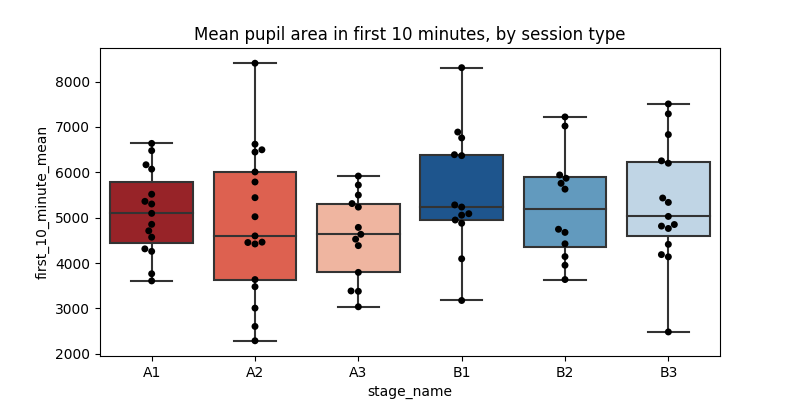

['black', 'black', 'black', 'black', 'black', 'black']
[(0.6663437139561708, 0.06339100346020761, 0.08641291810841982), (0.9570011534025374, 0.3087120338331411, 0.22191464821222606), (0.9882352941176471, 0.6866743560169165, 0.5778854286812765), (0.044059976931949255, 0.3338869665513264, 0.6244521337946944), (0.3262898885044214, 0.6186236063052672, 0.802798923490965), (0.7309496347558632, 0.8394771241830065, 0.9213225682429834)]


Text(0.5, 1.0, 'Mean pupil area in first 10 minutes, by session type')

In [22]:
fig,ax=plt.subplots(figsize=(8,4))

for plot,palette,alpha in zip([sns.swarmplot,sns.boxplot],[['black']*6,et.get_colors_for_session_numbers()],[1,0.5]):
    print(palette)
    plot(
        x='stage_name',
        y='first_10_minute_mean',
        data=early_session_means,
        order = np.sort(early_session_means['stage_name'].unique()),
        ax=ax,
        palette=palette,

    )
ax.set_title('Mean pupil area in first 10 minutes, by session type')

<IPython.core.display.Javascript object>


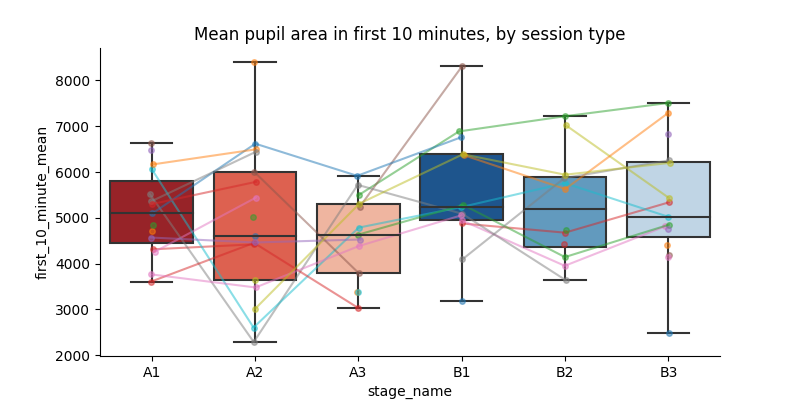

In [23]:
session_names = np.sort(early_session_means['stage_name'].unique())

fig,ax=plt.subplots(figsize=(8,4))
sns.boxplot(
    x='stage_name',
    y='first_10_minute_mean',
    data=early_session_means,
    order = np.sort(early_session_means['stage_name'].unique()),
    ax=ax,
    palette=et.get_colors_for_session_numbers(),
    )
ax.set_title('Mean pupil area in first 10 minutes, by session type')

for donor_id in early_session_means.donor_id.unique():
    df = early_session_means.query('donor_id == @donor_id')
    
    ax.plot(
        np.arange(6)+0.01*np.random.randn(6),
        [df.query('stage_name==@s')['first_10_minute_mean'].iloc[0] if len(df.query('stage_name==@s'))>0 else np.nan for s in session_names],
        marker='o',
        markersize=4,
        alpha=0.5
    )
sns.despine()

## look at an example in time

## look at pupil preceding first flashes and following last

In [24]:
first_stim_df = pd.DataFrame()
last_stim_df = pd.DataFrame()

duration = 10

for osid in behavior_dict.keys():
    ed = eye_dict[osid]
    bd = behavior_dict[osid]
    
    vs = bd.visual_stimuli[bd.visual_stimuli['image_name'].str.startswith('im')]
    first_stim = vs.iloc[0]['time']
    last_stim = vs.iloc[-1]['time']
    
    df = ed.ellipse_fits['pupil']
    if 'time' in df.columns:
        t = 'time'
    else:
        t = 't'
        
    if df.index.name == 't' or df.index.name == 'time':
        pass
    else:
        df.set_index(t,inplace=True)
    
    new_t = np.arange(-duration,duration,1/60.)
    if len(first_stim_df) == 0:
        first_stim_df['time'] = new_t
        last_stim_df['time'] = new_t
        
    first_stim_df[osid] = np.interp(
        new_t, 
        df.loc[first_stim-duration:first_stim+duration].index.values - first_stim, 
        df.loc[first_stim-duration:first_stim+duration]['normalized_blink_corrected_area'].values
    )
    last_stim_df[osid] = np.interp(
        new_t, 
        df.loc[last_stim-duration:last_stim+duration].index.values - last_stim, 
        df.loc[last_stim-duration:last_stim+duration]['normalized_blink_corrected_area'].values
    )
    

In [25]:
df

,center_x,center_y,height,phi,width,area,frame,likely_outlier,likely_blinks,blink_corrected_center_x,blink_corrected_center_y,blink_corrected_height,blink_corrected_phi,blink_corrected_width,blink_corrected_area,blink_corrected_likely_outlier,normalized_blink_corrected_area
time,,,,,,,,,,,,,,,,,
0.51230,295.864185,203.601508,43.092026,0.092459,45.783050,6585.053760,0,False,False,295.864185,203.601508,43.092026,0.092459,45.783050,6585.053760,0.0,0.559117
0.52564,292.682895,205.367668,43.452184,0.066941,46.646805,6835.868185,1,False,False,292.682895,205.367668,43.452184,0.066941,46.646805,6835.868185,0.0,0.580413
0.55437,288.721943,205.874677,42.458452,-0.036699,47.082273,6964.095515,2,False,False,288.721943,205.874677,42.458452,-0.036699,47.082273,6964.095515,0.0,0.591300
0.58778,286.936158,207.235889,41.739078,-0.084883,47.650017,7133.061921,3,False,False,286.936158,207.235889,41.739078,-0.084883,47.650017,7133.061921,0.0,0.605647
0.62132,287.398441,206.748546,42.167743,-0.127312,47.410153,7061.428766,4,False,False,287.398441,206.748546,42.167743,-0.127312,47.410153,7061.428766,0.0,0.599565
0.65444,289.196777,205.698207,42.562600,-0.023277,47.116514,6974.228517,5,False,False,289.196777,205.698207,42.562600,-0.023277,47.116514,6974.228517,0.0,0.592161
0.68777,291.207735,205.896213,42.415173,-0.055012,46.433585,6773.518246,6,False,False,291.207735,205.896213,42.415173,-0.055012,46.433585,6773.518246,0.0,0.575119
0.72118,290.650361,205.435114,43.019356,0.039697,46.281806,6729.309014,7,False,False,290.650361,205.435114,43.019356,0.039697,46.281806,6729.309014,0.0,0.571365
0.75450,290.570374,205.840943,42.579965,0.003055,46.145796,6689.815789,8,False,False,290.570374,205.840943,42.579965,0.003055,46.145796,6689.815789,0.0,0.568012


<IPython.core.display.Javascript object>


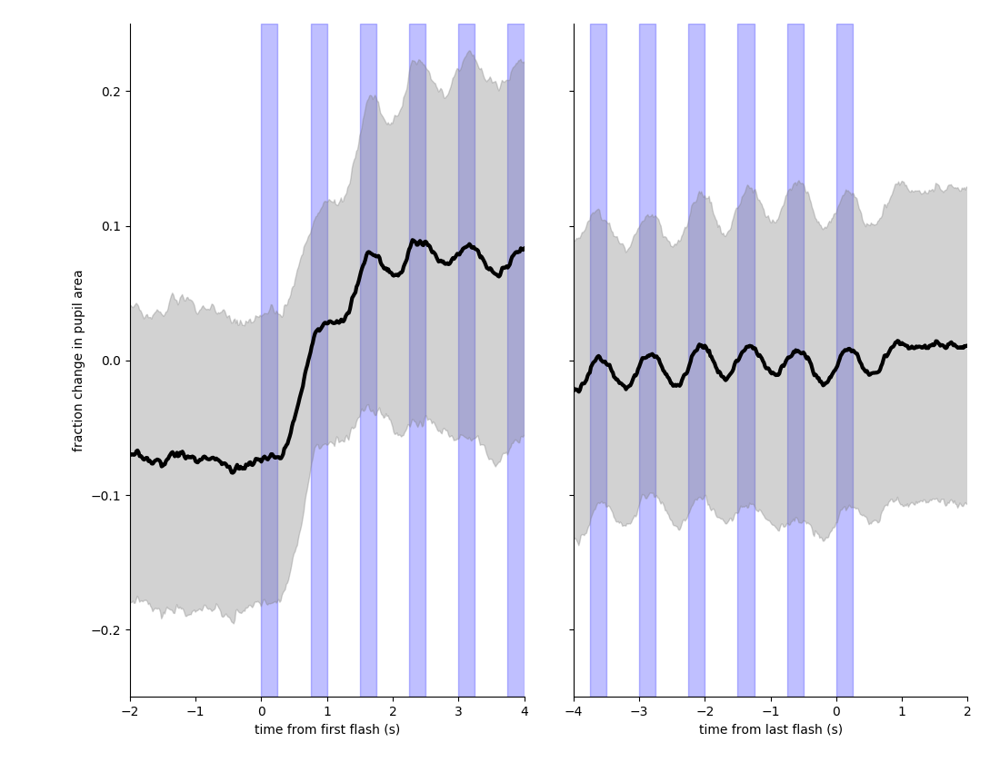

In [26]:
cols = [c for c in first_stim_df.columns if c != 'time']

fig,ax = plt.subplots(1,2,figsize=(6,6),sharey=True)

for ii,df in enumerate([first_stim_df,last_stim_df]):
    et.plot_event_triggered_response(
        df, 
        ax=ax[ii], 
        title='', 
        mean_subtract = False, 
        fraction = True,
        time_zero_subtract = False, 
        fg_color='black',
        bg_color='gray', 
        show_traces=False
    )


et.designate_flashes(ax[0],pre_color='white',post_color='blue')
et.designate_flashes(ax[1],pre_color='blue',post_color='white')
ax[1].axvspan(0,0.25,color='blue',alpha=0.25,zorder=-np.inf)
ax[0].set_xlim(-2,4)
ax[1].set_xlim(-4,2)
for axis in ax:
    axis.set_ylim(-.25,.25)
    
# ax[0].set_title('pupil diameter at beginning of flash sequence')
# ax[1].set_title('pupil diameter at end of flash sequence')
ax[0].set_xlabel('time from first flash (s)')
ax[1].set_xlabel('time from last flash (s)')
ax[0].set_ylabel('fraction change in pupil area')
fig.tight_layout()
sns.despine()

fig_title = 'pupil_oscillations_start_end'
if save_figures:
    vbp.save_figure(fig,os.path.join(figure_savefolder,fig_title),formats=['.pdf','.png'])

## plot pupil for each individual image

In [27]:
osid = 955991376
bd = et.open_behavior_data(osid)
ed = et.open_eye_data(osid)

opening behavior data for osid = 955991376


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening eye data for osid = 955991376


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

In [28]:
def make_image_response_plot(osid):
    ed = et.open_eye_data(osid)
    bd = et.open_behavior_data(osid)
    pupil_responses,running_responses = et.get_individual_image_responses(ed,bd)
    fig,ax = et.plot_individual_image_responses(pupil_responses,running_responses)
    return fig,ax

opening eye data for osid = 955991376


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

opening behavior data for osid = 955991376


/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecationWarning:

dataset.value has been deprecated. Use dataset[()] instead.

/home/dougo/.conda/envs/visual_behavior/lib/python3.7/site-packages/h5py/_hl/dataset.py:313: H5pyDeprecat

<IPython.core.display.Javascript object>


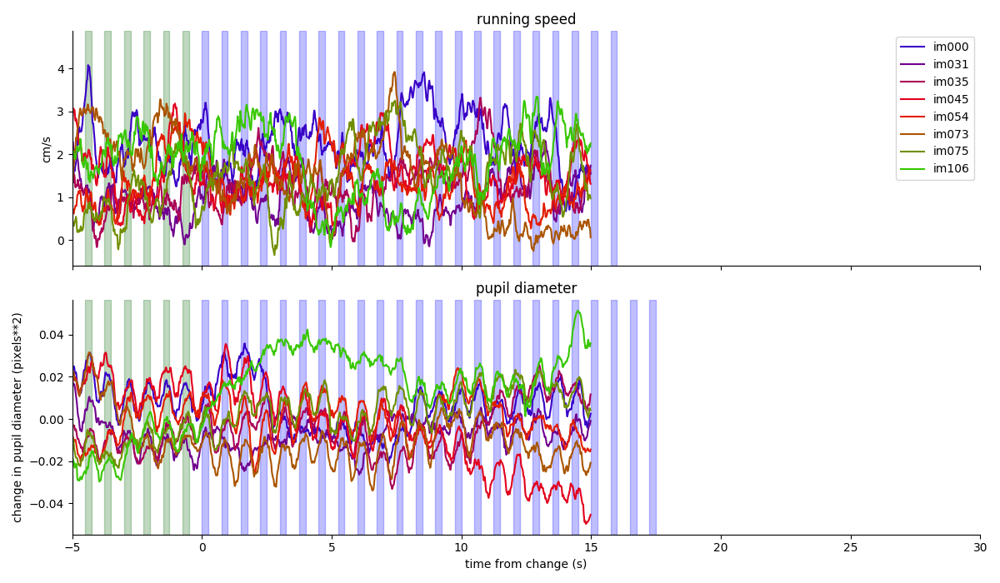

In [29]:
make_image_response_plot(osid);

In [63]:
osid = 906299056

In [64]:
ed = et.open_eye_data(osid)
bd = et.open_behavior_data(osid)
pupil_responses,running_responses = et.get_individual_image_responses(ed,bd)
    

opening eye data for osid = 906299056
opening behavior data for osid = 906299056


In [65]:
fig = plot_utils.plotly_event_triggered_response_plot(
    pupil_responses['im061'],
    x_value='time',
    y_values=[c for c in pupil_responses['im061'] if c!='time'],
    var_name='event_number', 
    value_name='pupil_diameter'
)
fig.show()

<IPython.core.display.Javascript object>


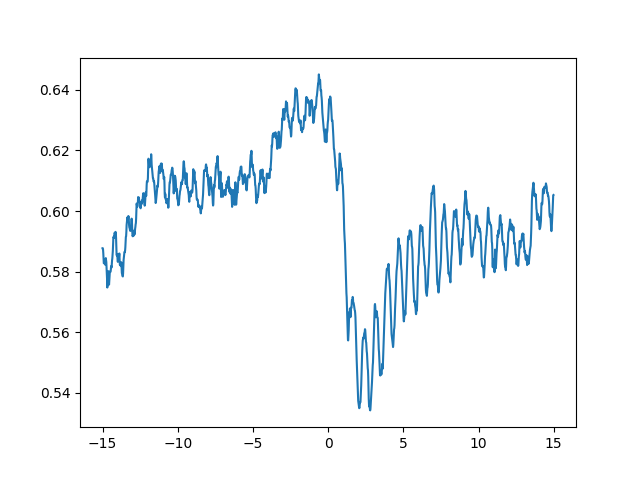

In [68]:
image = 'im061'
cols = [c for c in pupil_responses[image] if c!='time']
fig,ax=plt.subplots()
ax.plot(pupil_responses[image]['time'], pupil_responses[image][cols].mean(axis=1))

<IPython.core.display.Javascript object>


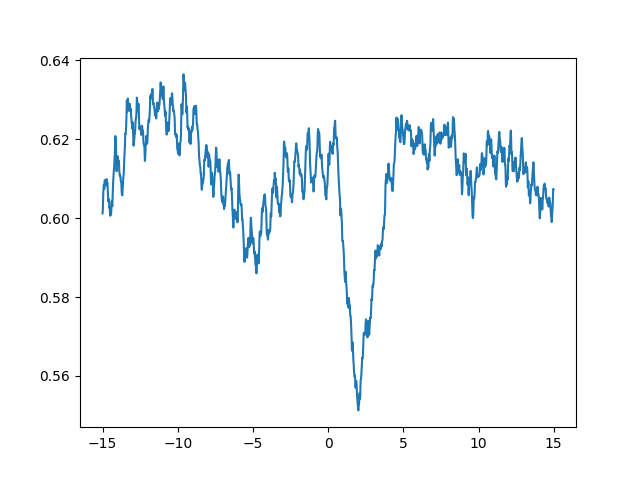

In [69]:
image = 'im069'
cols = [c for c in pupil_responses[image] if c!='time']
fig,ax=plt.subplots()
ax.plot(pupil_responses[image]['time'], pupil_responses[image][cols].mean(axis=1))

In [33]:
first_times = bd.visual_stimuli.query('image_name == "im000" and consecutive_flashes == 0')['time']
first_times.iloc[32]

3004.72911

In [34]:
osid

955991376

In [35]:
import numpy as np
import matplotlib.pyplot as plt
import scipy.fftpack

def plotFFT(t,y,sampling_rate,ax=None):
   
    if ax is None:
        fig,ax = plt.subplots()
        
    N = np.max(t)*sampling_rate
    yf = scipy.fftpack.fft(y)
    tf = np.linspace(0.0, sampling_rate/(2.0), N/2)
    
    ax.plot(tf, 2.0/N * np.abs(yf[0:int(N/2)]))

In [36]:
# Number of samplepoints

# sample spacing
sampling_rate = 60 #Hz
T_final = 20 #seconds
N = T_final*sampling_rate
t = np.linspace(0.0, T_final, N)

mode1 = 5
mode2 = 20
y = np.sin(mode1*2.0*np.pi*t) + 0.5*np.sin(mode2*2.0*np.pi*t) + np.random.randn(len(t)) + 2

<IPython.core.display.Javascript object>


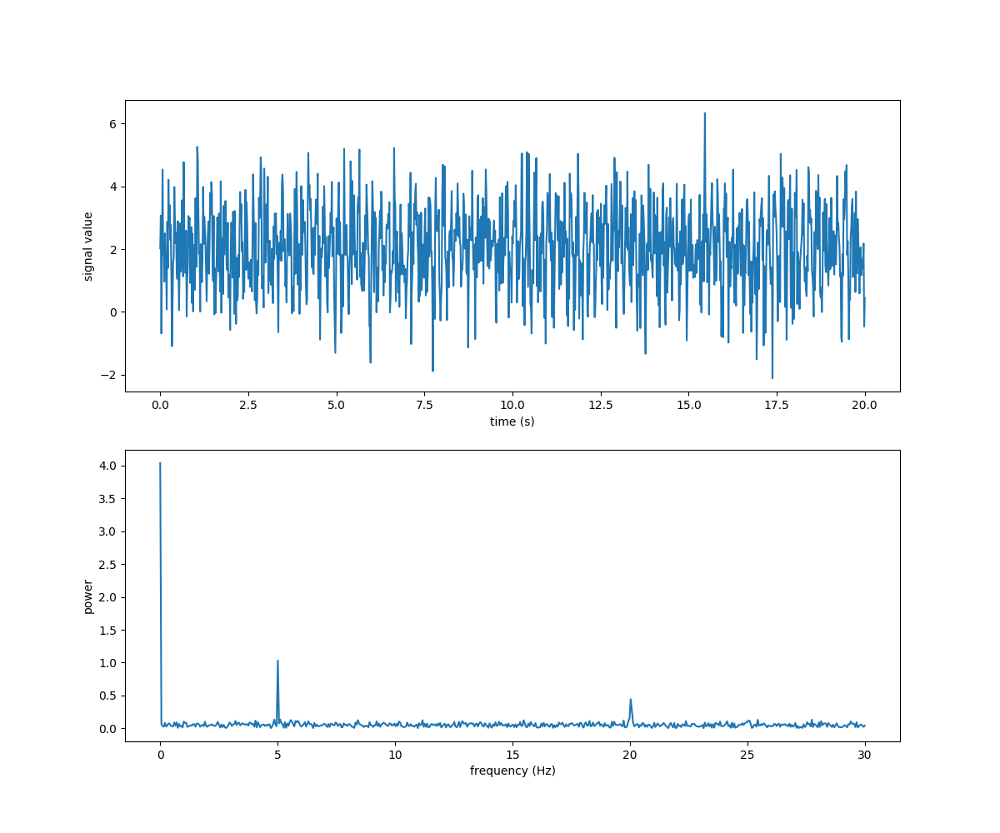

Text(0, 0.5, 'signal value')

In [37]:
fig, ax = plt.subplots(2,1,figsize=(12,10))
ax[0].plot(t,y)
plotFFT(t,y,sampling_rate,ax=ax[1])

ax[1].set_xlabel('frequency (Hz)')
ax[1].set_ylabel('power')

ax[0].set_xlabel('time (s)')
ax[0].set_ylabel('signal value')

<IPython.core.display.Javascript object>


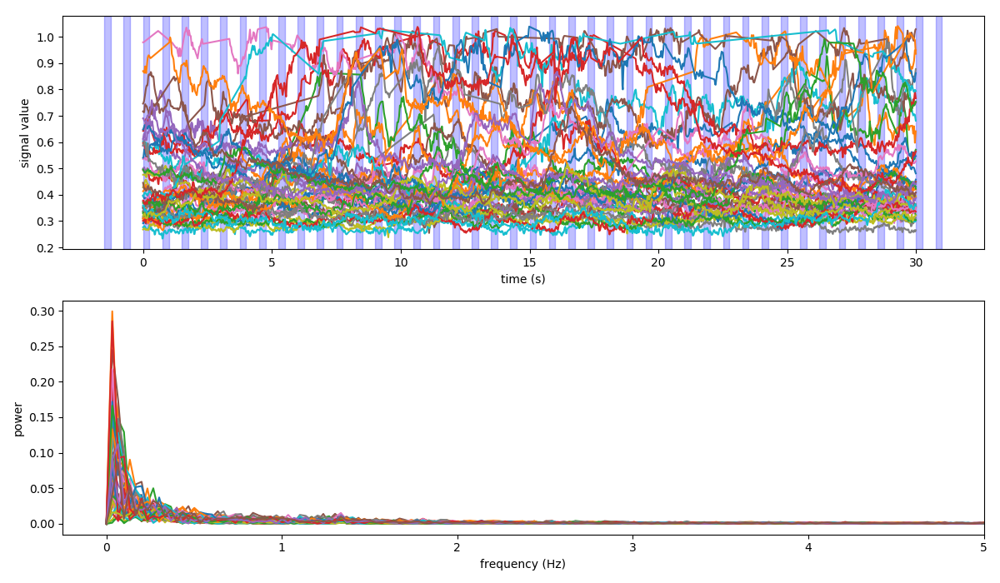

In [38]:
fig, ax = plt.subplots(2,1,figsize=(12,7))

df = pupil_responses['im000']
cols = [c for c in df.columns if c!='time']

t = df['time'].values - df['time'].values.min()

for col in cols:
    
    y = df[col].values

    ax[0].plot(t,y)
    plotFFT(
        t,
        y-np.mean(y),
        sampling_rate=60,
        ax=ax[1]
    )

ax[1].set_xlabel('frequency (Hz)')
ax[1].set_ylabel('power')

et.designate_flashes(ax[0])

ax[0].set_xlabel('time (s)')
ax[0].set_ylabel('signal value')

ax[1].set_xlim(-0.25,5)

fig.tight_layout()

In [70]:
osid

906299056

In [40]:
1/1.88

0.5319148936170213

In [41]:
9.2-8.6

0.5999999999999996

In [42]:
12.2 - 11.55

0.6499999999999986

In [43]:
import plotly.express as px


In [44]:
df = pupil_responses['im000']
df

,time,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45
0,-15.000000,0.396966,0.334515,0.354822,0.493717,0.499414,0.310568,0.299811,0.316891,0.428150,0.276837,0.291648,0.309018,0.335353,0.642632,0.609623,0.716546,0.356955,0.374133,0.268283,0.602637,0.350675,0.310653,0.329216,0.301398,0.586067,0.348430,0.536232,0.339743,0.476211,0.359972,0.540684,0.413189,0.369065,0.596637,0.690369,0.445584,0.978894,0.587876,0.320273,0.394614,0.647962,0.869514,0.496048,0.378164,0.613751,0.746126
1,-14.983333,0.395180,0.334515,0.354822,0.493717,0.500073,0.310568,0.302526,0.316723,0.428150,0.276837,0.291648,0.309157,0.333398,0.642632,0.615046,0.715253,0.356955,0.374133,0.269370,0.602637,0.348263,0.310653,0.326341,0.301398,0.593693,0.349641,0.536232,0.339743,0.476211,0.359972,0.543375,0.413541,0.368788,0.596380,0.689394,0.437544,0.978894,0.588207,0.323237,0.394614,0.650437,0.869514,0.492802,0.377929,0.620377,0.749139
2,-14.966667,0.389065,0.332632,0.355733,0.494316,0.503594,0.310652,0.309437,0.316409,0.434729,0.278516,0.297316,0.312337,0.331113,0.650984,0.623349,0.712819,0.359057,0.372029,0.271945,0.598975,0.341569,0.310001,0.323027,0.301717,0.604644,0.354060,0.537935,0.339409,0.476506,0.355823,0.559826,0.417163,0.367617,0.594221,0.684327,0.425179,0.980005,0.596002,0.327016,0.399931,0.656120,0.866553,0.488495,0.371600,0.630549,0.754286
3,-14.950000,0.385167,0.330449,0.357940,0.497061,0.504123,0.311452,0.310900,0.314897,0.442175,0.281457,0.303902,0.315062,0.333881,0.660220,0.622716,0.718187,0.366568,0.364920,0.272633,0.594449,0.339777,0.308817,0.321146,0.304648,0.607479,0.357155,0.541545,0.337642,0.477539,0.345090,0.572790,0.420962,0.367216,0.591363,0.680048,0.422506,0.981205,0.603798,0.328417,0.406990,0.660743,0.863106,0.485956,0.365549,0.630572,0.762320
4,-14.933333,0.386501,0.338026,0.362193,0.495848,0.492061,0.311273,0.303445,0.312429,0.448939,0.280991,0.300823,0.306916,0.337506,0.661599,0.617319,0.737792,0.373424,0.359124,0.270804,0.595394,0.346476,0.309932,0.319472,0.306436,0.606521,0.356711,0.541642,0.336055,0.477457,0.339622,0.567956,0.426214,0.369507,0.583233,0.678931,0.425127,0.982540,0.599778,0.329166,0.408503,0.664022,0.874255,0.483985,0.365952,0.627921,0.772547
5,-14.916667,0.387599,0.347190,0.372048,0.487407,0.481360,0.301985,0.302398,0.313329,0.455617,0.277916,0.296220,0.299311,0.340580,0.662139,0.633952,0.744174,0.378671,0.356375,0.268976,0.597720,0.346422,0.312923,0.317983,0.299381,0.609492,0.357472,0.537800,0.335279,0.474636,0.342503,0.562264,0.431371,0.371481,0.575434,0.678188,0.422007,0.983909,0.594061,0.322347,0.408247,0.665451,0.887835,0.484808,0.366491,0.635108,0.784153
6,-14.900000,0.388153,0.347149,0.376263,0.482456,0.476515,0.295018,0.319992,0.316939,0.456500,0.274592,0.293064,0.304989,0.343559,0.674288,0.662106,0.738659,0.382164,0.355520,0.267148,0.598394,0.334560,0.313343,0.316523,0.292325,0.614100,0.361485,0.534779,0.334860,0.471539,0.343667,0.552295,0.435703,0.372390,0.570662,0.678968,0.415704,0.985195,0.580728,0.313505,0.406046,0.662327,0.877084,0.486527,0.369656,0.644763,0.796757
7,-14.883333,0.387530,0.345502,0.372150,0.484116,0.474570,0.308625,0.324286,0.313517,0.456616,0.271083,0.290146,0.310354,0.340489,0.687659,0.671070,0.736549,0.375725,0.359264,0.266275,0.598154,0.326010,0.311750,0.320909,0.304069,0.612263,0.365481,0.532667,0.336027,0.467768,0.342202,0.545344,0.438555,0.373714,0.565320,0.679560,0.414525,0.986474,0.567547,0.311310,0.403233,0.659796,0.862126,0.488234,0.372433,0.663088,0.806145
8,-14.866667,0.384146,0.349012,0.370171,0.487407,0.486239,0.320506,0.306048,0.304561,0.451624,0.268631,0.299310,0.304341,0.336406,0.689136,0.670272,0.737427,0.374265,0.360156,0.268327,0.588659,0.327993,0.310033,0.326092,0.315133,0.607639,0.369163,0.532901,0.336256,0.466823,0.338651,0.552796,0.429085,0.376362,0.555691,0.677011,0.416087,0.987758,0.557651,0.310837,0.400857,0.658039,0.874953,0.489937,0.368470,0.683667,0.813056
9,-14.850000,0.382059,0